In [2]:
# Exploratory Data Analysis - Order Export Data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

# Set visualization style
sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (12, 6)

# Load the data
df = pd.read_csv('data/order_export_20250930T20240405.csv')

print("Dataset Shape:", df.shape)
print("\nFirst few rows:")
df.head()


Dataset Shape: (60930, 8)

First few rows:


,order_id,updated,store,email,product_code,name,quantity,line_price
0,27539,2025-09-29T20:55,Bosund kiosk,jonathan.ahlo@hotmail.com,6.406510e+12,Hetki kärnfria Vindruvor 500g,1.0,2.79
1,27539,2025-09-29T20:55,Bosund kiosk,jonathan.ahlo@hotmail.com,2.400032e+12,GURKA,1.0,1.00
2,27539,2025-09-29T20:55,Bosund kiosk,jonathan.ahlo@hotmail.com,6.405304e+12,Kokkikartano Laxsoppa 350g,3.0,13.77
3,27539,2025-09-29T20:55,Bosund kiosk,jonathan.ahlo@hotmail.com,2.400046e+12,Träskulla Ekobeef NÖT MALETKÖTT frusen 500g,1.0,8.99
4,27538,2025-09-29T20:46,Bosund kiosk,victoriagrankulla96@hotmail.com,2.400032e+12,GURKA,1.0,1.00


In [3]:
# Data Info and Missing Values
print("=" * 60)
print("DATA INFORMATION")
print("=" * 60)
df.info()

print("\n" + "=" * 60)
print("MISSING VALUES")
print("=" * 60)
missing = df.isnull().sum()
missing_pct = (missing / len(df)) * 100
missing_df = pd.DataFrame({'Missing Count': missing, 'Percentage': missing_pct})
print(missing_df[missing_df['Missing Count'] > 0])

print("\n" + "=" * 60)
print("BASIC STATISTICS")
print("=" * 60)
print(df.describe())


DATA INFORMATION
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60930 entries, 0 to 60929
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   order_id      60930 non-null  int64  
 1   updated       60930 non-null  object 
 2   store         60930 non-null  object 
 3   email         60930 non-null  object 
 4   product_code  60174 non-null  float64
 5   name          60930 non-null  object 
 6   quantity      60930 non-null  float64
 7   line_price    60930 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 3.7+ MB

MISSING VALUES
              Missing Count  Percentage
product_code            756    1.240768

BASIC STATISTICS
           order_id  product_code      quantity    line_price
count  60930.000000  6.017400e+04  60930.000000  60930.000000
mean   14446.368095  3.433453e+12      1.099202      3.623784
std     7670.291186  2.748086e+12      0.694165      3.481974
min        1.000000  

In [4]:
# Data Cleaning and Preparation
# Convert updated column to datetime
df['updated'] = pd.to_datetime(df['updated'])

# Extract temporal features
df['date'] = df['updated'].dt.date
df['hour'] = df['updated'].dt.hour
df['day_of_week'] = df['updated'].dt.day_name()
df['month'] = df['updated'].dt.month
df['year'] = df['updated'].dt.year

# Calculate total revenue per order line
df['total_revenue'] = df['quantity'] * df['line_price']

print("Data prepared successfully!")
print(f"\nDate range: {df['updated'].min()} to {df['updated'].max()}")
print(f"Total unique orders: {df['order_id'].nunique():,}")
print(f"Total unique customers: {df['email'].nunique():,}")
print(f"Total unique products: {df['name'].nunique():,}")
print(f"Total unique stores: {df['store'].nunique()}")
print(f"\nTotal revenue: €{df['total_revenue'].sum():,.2f}")


Data prepared successfully!

Date range: 2024-04-05 16:41:00 to 2025-09-29 20:55:00
Total unique orders: 23,649
Total unique customers: 3,398
Total unique products: 406
Total unique stores: 9

Total revenue: €291,606.73


STORE PERFORMANCE ANALYSIS
                  Total Orders  Unique Customers  Revenue (€)  Items Sold  \
store                                                                       
Bosund kiosk              5594               701     63318.04    15800.46   
Torp kiosk                3347               616     49744.58     9739.73   
Sisbacka kiosk            3850               568     48479.10    13090.38   
V-lift kiosk              2455               584     33100.09     7056.10   
Kronoby kiosk             2730               418     32666.59     7170.32   
Granholmen kiosk          1352               417     19526.15     3459.69   
Holm kiosk                1665               486     16700.48     4091.32   
Lager kållby              1564               602     16104.60     3909.71   
Sunds kiosk               1092               414     11967.11     2656.67   

                  Avg Order Value (€)  
store                                  
Bosund kiosk                    11.32  
Torp 

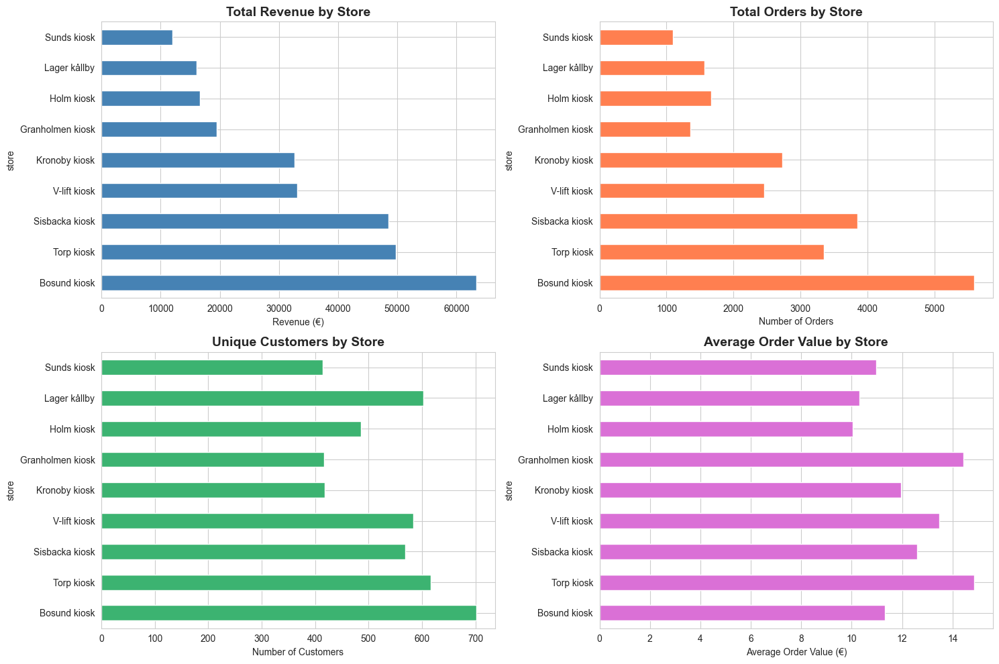

In [5]:
# STORE ANALYSIS
print("=" * 60)
print("STORE PERFORMANCE ANALYSIS")
print("=" * 60)

store_stats = df.groupby('store').agg({
    'order_id': 'nunique',
    'email': 'nunique',
    'total_revenue': 'sum',
    'quantity': 'sum'
}).round(2)
store_stats.columns = ['Total Orders', 'Unique Customers', 'Revenue (€)', 'Items Sold']
store_stats = store_stats.sort_values('Revenue (€)', ascending=False)
store_stats['Avg Order Value (€)'] = (store_stats['Revenue (€)'] / store_stats['Total Orders']).round(2)

print(store_stats)

# Visualization
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Revenue by store
store_stats['Revenue (€)'].plot(kind='barh', ax=axes[0, 0], color='steelblue')
axes[0, 0].set_title('Total Revenue by Store', fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel('Revenue (€)')

# Orders by store
store_stats['Total Orders'].plot(kind='barh', ax=axes[0, 1], color='coral')
axes[0, 1].set_title('Total Orders by Store', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('Number of Orders')

# Customers by store
store_stats['Unique Customers'].plot(kind='barh', ax=axes[1, 0], color='mediumseagreen')
axes[1, 0].set_title('Unique Customers by Store', fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel('Number of Customers')

# Average order value by store
store_stats['Avg Order Value (€)'].plot(kind='barh', ax=axes[1, 1], color='orchid')
axes[1, 1].set_title('Average Order Value by Store', fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel('Average Order Value (€)')

plt.tight_layout()
plt.show()


TOP 20 PRODUCTS BY REVENUE
                                    Total Revenue (€)  Units Sold  Orders
name                                                                     
Essegg ÄGG M 30 st/bricka                    26175.30     2983.00    2435
GURKA                                        23776.00    11144.00    6857
Torp. JORDGUBBAR 250g.                       15479.10     1884.00    1266
Essegg ÄGG 15 st/ask                         11659.10     2589.00    2106
GLASS olika smaker 480 ml                    11516.10     1085.00     852
Tomat ENCORE, röd vanlig, LÖS                11304.09     3377.11    4474
Tomat Mix 250g / GOURAMI grön 250g           10236.00     2110.00    1757
Tomat BAMANO ask 250g (pärl gul)              6745.50     1778.00    1558
Tomat II KLASS LÖS                            6471.59     2684.56    2725
Tomat GOURAMI 250g ask (grön)                 6284.50     1247.00    1027
Tomat ORGANZA (gul/plommon) LÖS               5061.84     1224.58    2403
Tomat DELIS

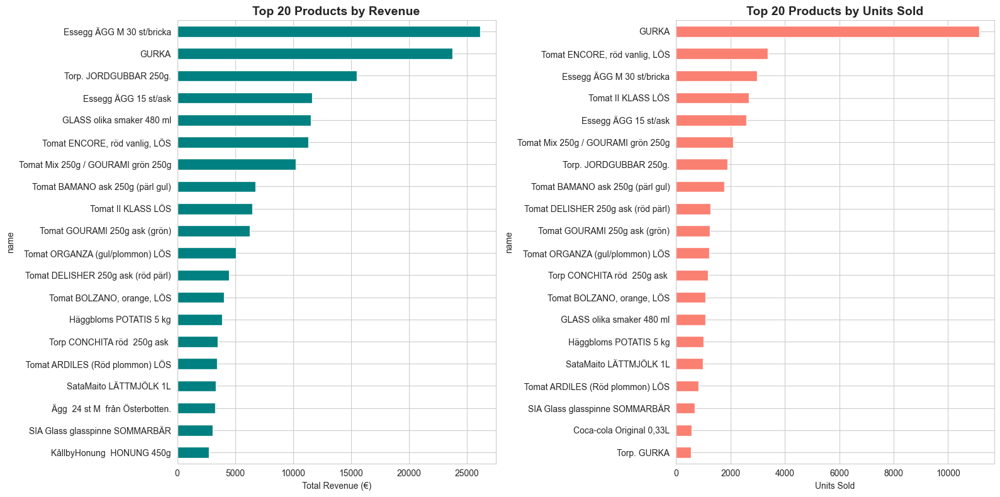

In [6]:
# PRODUCT ANALYSIS
print("=" * 60)
print("TOP 20 PRODUCTS BY REVENUE")
print("=" * 60)

product_stats = df.groupby('name').agg({
    'total_revenue': 'sum',
    'quantity': 'sum',
    'order_id': 'nunique'
}).round(2)
product_stats.columns = ['Total Revenue (€)', 'Units Sold', 'Orders']
product_stats = product_stats.sort_values('Total Revenue (€)', ascending=False)

print(product_stats.head(20))

# Visualize top 20 products
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Top 20 by revenue
top_20_revenue = product_stats.head(20)
top_20_revenue['Total Revenue (€)'].plot(kind='barh', ax=axes[0], color='teal')
axes[0].set_title('Top 20 Products by Revenue', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Total Revenue (€)')
axes[0].invert_yaxis()

# Top 20 by units sold
top_20_units = product_stats.sort_values('Units Sold', ascending=False).head(20)
top_20_units['Units Sold'].plot(kind='barh', ax=axes[1], color='salmon')
axes[1].set_title('Top 20 Products by Units Sold', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Units Sold')
axes[1].invert_yaxis()

plt.tight_layout()
plt.show()


TEMPORAL PATTERNS

Daily Revenue Statistics:
Average daily revenue: €555.44
Max daily revenue: €3,903.69
Min daily revenue: €0.40


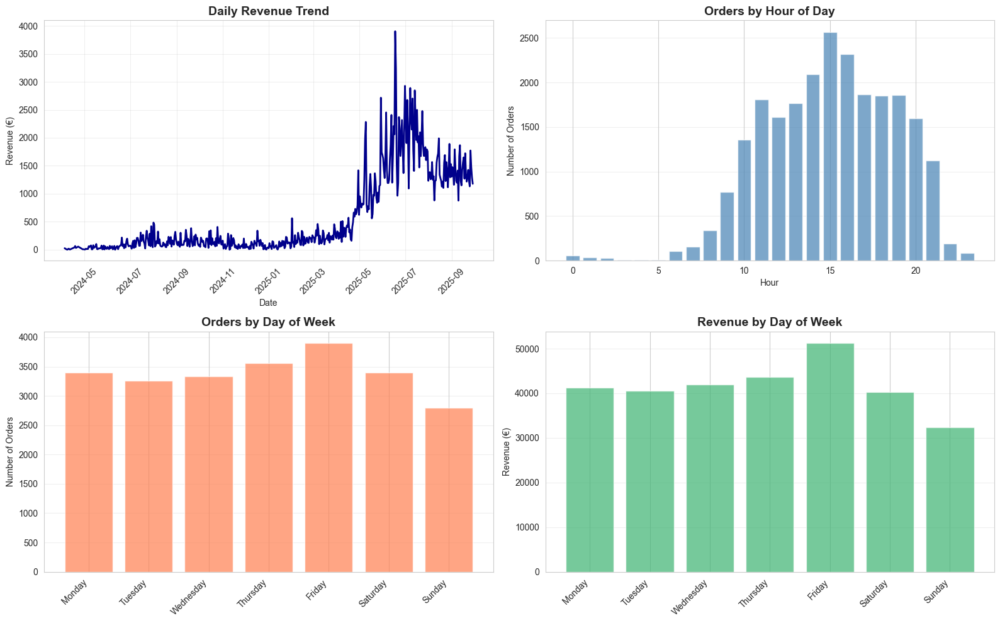

In [7]:
# TIME SERIES ANALYSIS
print("=" * 60)
print("TEMPORAL PATTERNS")
print("=" * 60)

# Daily revenue trend
daily_revenue = df.groupby('date')['total_revenue'].sum().reset_index()
daily_revenue['date'] = pd.to_datetime(daily_revenue['date'])

print(f"\nDaily Revenue Statistics:")
print(f"Average daily revenue: €{daily_revenue['total_revenue'].mean():,.2f}")
print(f"Max daily revenue: €{daily_revenue['total_revenue'].max():,.2f}")
print(f"Min daily revenue: €{daily_revenue['total_revenue'].min():,.2f}")

# Visualization
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

# Daily revenue trend
axes[0, 0].plot(daily_revenue['date'], daily_revenue['total_revenue'], linewidth=2, color='darkblue')
axes[0, 0].set_title('Daily Revenue Trend', fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel('Date')
axes[0, 0].set_ylabel('Revenue (€)')
axes[0, 0].grid(True, alpha=0.3)
axes[0, 0].tick_params(axis='x', rotation=45)

# Orders by hour of day
hourly_orders = df.groupby('hour')['order_id'].nunique()
axes[0, 1].bar(hourly_orders.index, hourly_orders.values, color='steelblue', alpha=0.7)
axes[0, 1].set_title('Orders by Hour of Day', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('Hour')
axes[0, 1].set_ylabel('Number of Orders')
axes[0, 1].grid(True, alpha=0.3, axis='y')

# Orders by day of week
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_counts = df.groupby('day_of_week')['order_id'].nunique().reindex(day_order)
axes[1, 0].bar(range(len(day_counts)), day_counts.values, color='coral', alpha=0.7)
axes[1, 0].set_xticks(range(len(day_counts)))
axes[1, 0].set_xticklabels(day_counts.index, rotation=45, ha='right')
axes[1, 0].set_title('Orders by Day of Week', fontsize=14, fontweight='bold')
axes[1, 0].set_ylabel('Number of Orders')
axes[1, 0].grid(True, alpha=0.3, axis='y')

# Revenue by day of week
day_revenue = df.groupby('day_of_week')['total_revenue'].sum().reindex(day_order)
axes[1, 1].bar(range(len(day_revenue)), day_revenue.values, color='mediumseagreen', alpha=0.7)
axes[1, 1].set_xticks(range(len(day_revenue)))
axes[1, 1].set_xticklabels(day_revenue.index, rotation=45, ha='right')
axes[1, 1].set_title('Revenue by Day of Week', fontsize=14, fontweight='bold')
axes[1, 1].set_ylabel('Revenue (€)')
axes[1, 1].grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()


CUSTOMER BEHAVIOR ANALYSIS

Top 20 Customers by Revenue:
                                Orders  Total Spent (€)  Items Purchased  \
email                                                                      
ullabritt.snellman@hotmail.com     135          3181.88           414.46   
lucyp240491@gmail.com               45          1870.77           189.70   
slotte47@gmail.com                  56          1788.66           219.28   
josefinsnellman@msn.com            159          1737.54           339.55   
neumanrosemaj@gmail.com             56          1577.58           352.61   
ronnqvist.ra.ma@gmail.com           35          1515.35           235.16   
jonathan.ahlo@hotmail.com           46          1506.53           244.30   
ralf.snellman@torpfrys.fi          154          1402.74           269.58   
heidi.ahlo@hotmail.com              54          1243.40           312.20   
tomjarn680@gmail.com                33          1206.20            95.35   
ahlvikemma@gmail.com           

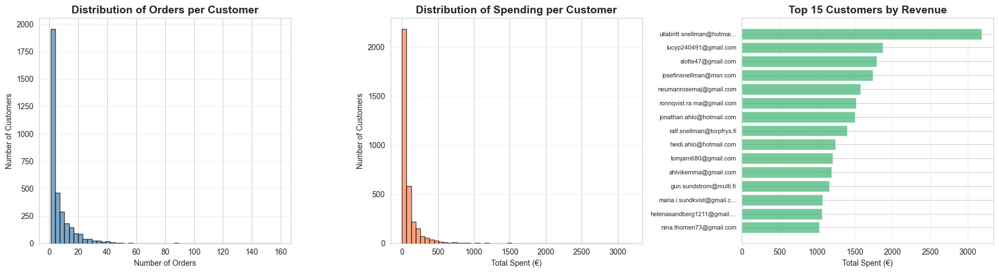

In [8]:
# CUSTOMER ANALYSIS
print("=" * 60)
print("CUSTOMER BEHAVIOR ANALYSIS")
print("=" * 60)

# Customer statistics
customer_stats = df.groupby('email').agg({
    'order_id': 'nunique',
    'total_revenue': 'sum',
    'quantity': 'sum'
}).round(2)
customer_stats.columns = ['Orders', 'Total Spent (€)', 'Items Purchased']
customer_stats = customer_stats.sort_values('Total Spent (€)', ascending=False)
customer_stats['Avg Order Value (€)'] = (customer_stats['Total Spent (€)'] / customer_stats['Orders']).round(2)

print("\nTop 20 Customers by Revenue:")
print(customer_stats.head(20))

print("\n" + "=" * 60)
print("Customer Segmentation:")
print("=" * 60)
print(f"One-time customers: {(customer_stats['Orders'] == 1).sum()}")
print(f"Repeat customers (2-5 orders): {((customer_stats['Orders'] >= 2) & (customer_stats['Orders'] <= 5)).sum()}")
print(f"Loyal customers (6-10 orders): {((customer_stats['Orders'] >= 6) & (customer_stats['Orders'] <= 10)).sum()}")
print(f"VIP customers (>10 orders): {(customer_stats['Orders'] > 10).sum()}")

# Visualization
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Distribution of orders per customer
axes[0].hist(customer_stats['Orders'], bins=50, color='steelblue', alpha=0.7, edgecolor='black')
axes[0].set_title('Distribution of Orders per Customer', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Number of Orders')
axes[0].set_ylabel('Number of Customers')
axes[0].grid(True, alpha=0.3, axis='y')

# Distribution of spending per customer
axes[1].hist(customer_stats['Total Spent (€)'], bins=50, color='coral', alpha=0.7, edgecolor='black')
axes[1].set_title('Distribution of Spending per Customer', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Total Spent (€)')
axes[1].set_ylabel('Number of Customers')
axes[1].grid(True, alpha=0.3, axis='y')

# Top 15 customers
top_customers = customer_stats.head(15)
axes[2].barh(range(len(top_customers)), top_customers['Total Spent (€)'], color='mediumseagreen', alpha=0.7)
axes[2].set_yticks(range(len(top_customers)))
axes[2].set_yticklabels([email[:25] + '...' if len(email) > 25 else email for email in top_customers.index], fontsize=8)
axes[2].set_title('Top 15 Customers by Revenue', fontsize=14, fontweight='bold')
axes[2].set_xlabel('Total Spent (€)')
axes[2].invert_yaxis()
axes[2].grid(True, alpha=0.3, axis='x')

plt.tight_layout()
plt.show()


ORDER STATISTICS

Order Value Statistics:
Average order value: €12.33
Median order value: €7.68
Max order value: €764.40
Min order value: €0.00

Items per Order:
Average items per order: 2.83
Median items per order: 2.27


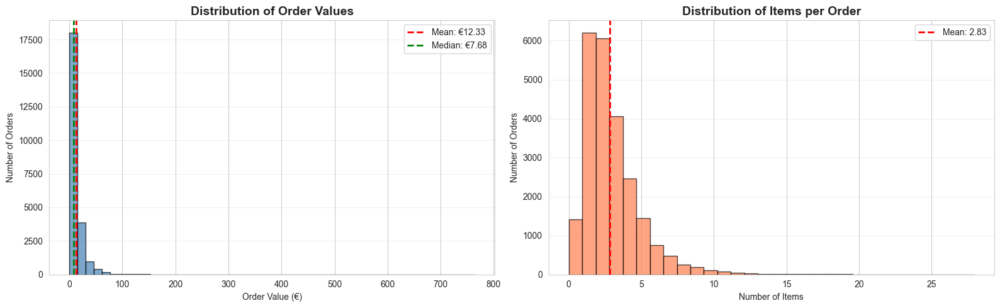

In [9]:
# ORDER ANALYSIS
print("=" * 60)
print("ORDER STATISTICS")
print("=" * 60)

order_stats = df.groupby('order_id').agg({
    'total_revenue': 'sum',
    'quantity': 'sum',
    'name': 'count'
}).round(2)
order_stats.columns = ['Order Value (€)', 'Total Items', 'Unique Products']

print(f"\nOrder Value Statistics:")
print(f"Average order value: €{order_stats['Order Value (€)'].mean():.2f}")
print(f"Median order value: €{order_stats['Order Value (€)'].median():.2f}")
print(f"Max order value: €{order_stats['Order Value (€)'].max():.2f}")
print(f"Min order value: €{order_stats['Order Value (€)'].min():.2f}")

print(f"\nItems per Order:")
print(f"Average items per order: {order_stats['Total Items'].mean():.2f}")
print(f"Median items per order: {order_stats['Total Items'].median():.2f}")

# Visualization
fig, axes = plt.subplots(1, 2, figsize=(16, 5))

# Distribution of order values
axes[0].hist(order_stats['Order Value (€)'], bins=50, color='steelblue', alpha=0.7, edgecolor='black')
axes[0].set_title('Distribution of Order Values', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Order Value (€)')
axes[0].set_ylabel('Number of Orders')
axes[0].axvline(order_stats['Order Value (€)'].mean(), color='red', linestyle='--', linewidth=2, label=f'Mean: €{order_stats["Order Value (€)"].mean():.2f}')
axes[0].axvline(order_stats['Order Value (€)'].median(), color='green', linestyle='--', linewidth=2, label=f'Median: €{order_stats["Order Value (€)"].median():.2f}')
axes[0].legend()
axes[0].grid(True, alpha=0.3, axis='y')

# Distribution of items per order
axes[1].hist(order_stats['Total Items'], bins=30, color='coral', alpha=0.7, edgecolor='black')
axes[1].set_title('Distribution of Items per Order', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Number of Items')
axes[1].set_ylabel('Number of Orders')
axes[1].axvline(order_stats['Total Items'].mean(), color='red', linestyle='--', linewidth=2, label=f'Mean: {order_stats["Total Items"].mean():.2f}')
axes[1].legend()
axes[1].grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()


In [10]:
# FINAL SUMMARY & KEY INSIGHTS
print("=" * 80)
print(" " * 25 + "EXECUTIVE SUMMARY")
print("=" * 80)

total_orders = df['order_id'].nunique()
total_customers = df['email'].nunique()
total_revenue = df['total_revenue'].sum()
avg_order_value = total_revenue / total_orders
total_products = df['name'].nunique()
total_items = df['quantity'].sum()

print(f"\n📊 BUSINESS OVERVIEW")
print(f"{'-' * 80}")
print(f"Total Orders:           {total_orders:,}")
print(f"Total Customers:        {total_customers:,}")
print(f"Total Revenue:          €{total_revenue:,.2f}")
print(f"Average Order Value:    €{avg_order_value:.2f}")
print(f"Total Products:         {total_products:,}")
print(f"Total Items Sold:       {total_items:,.0f}")

print(f"\n🏪 STORE PERFORMANCE")
print(f"{'-' * 80}")
top_store = store_stats.index[0]
print(f"Best performing store:  {top_store}")
print(f"  - Revenue: €{store_stats.loc[top_store, 'Revenue (€)']:,.2f}")
print(f"  - Orders: {store_stats.loc[top_store, 'Total Orders']:,.0f}")

print(f"\n🛒 PRODUCT INSIGHTS")
print(f"{'-' * 80}")
top_product = product_stats.index[0]
print(f"Top product by revenue: {top_product[:60]}")
print(f"  - Revenue: €{product_stats.loc[top_product, 'Total Revenue (€)']:,.2f}")
print(f"  - Units sold: {product_stats.loc[top_product, 'Units Sold']:,.0f}")

print(f"\n👥 CUSTOMER INSIGHTS")
print(f"{'-' * 80}")
one_time = (customer_stats['Orders'] == 1).sum()
repeat = (customer_stats['Orders'] > 1).sum()
retention_rate = (repeat / total_customers) * 100
print(f"One-time customers:     {one_time:,} ({(one_time/total_customers)*100:.1f}%)")
print(f"Repeat customers:       {repeat:,} ({retention_rate:.1f}%)")
print(f"Customer retention rate: {retention_rate:.1f}%")

print(f"\n⏰ TEMPORAL PATTERNS")
print(f"{'-' * 80}")
busiest_hour = df.groupby('hour')['order_id'].nunique().idxmax()
busiest_day = df.groupby('day_of_week')['order_id'].nunique().idxmax()
print(f"Busiest hour:           {busiest_hour}:00")
print(f"Busiest day:            {busiest_day}")

print("\n" + "=" * 80)
print(" " * 25 + "END OF ANALYSIS")
print("=" * 80)


                         EXECUTIVE SUMMARY

📊 BUSINESS OVERVIEW
--------------------------------------------------------------------------------
Total Orders:           23,649
Total Customers:        3,398
Total Revenue:          €291,606.73
Average Order Value:    €12.33
Total Products:         406
Total Items Sold:       66,974

🏪 STORE PERFORMANCE
--------------------------------------------------------------------------------
Best performing store:  Bosund kiosk
  - Revenue: €63,318.04
  - Orders: 5,594

🛒 PRODUCT INSIGHTS
--------------------------------------------------------------------------------
Top product by revenue: Essegg ÄGG M 30 st/bricka
  - Revenue: €26,175.30
  - Units sold: 2,983

👥 CUSTOMER INSIGHTS
--------------------------------------------------------------------------------
One-time customers:     963 (28.3%)
Repeat customers:       2,435 (71.7%)
Customer retention rate: 71.7%

⏰ TEMPORAL PATTERNS
--------------------------------------------------------------

Orders for ralf.snellman@torpfrys.fi:


,order_id,updated,store,name,quantity,line_price
2349,26538,2025-09-22 11:31:00,Torp kiosk,Kokkikartano Laxsoppa 350g,1.0,4.59
3371,26139,2025-09-19 10:26:00,Torp kiosk,"Coca-cola Original 0,33L",1.0,1.49
3372,26139,2025-09-19 10:26:00,Torp kiosk,Kokkikartano Laxsoppa 350g,2.0,9.18
3373,26139,2025-09-19 10:26:00,Torp kiosk,Maitokolmio Profit Choklad Proteinpudding 150 g,1.0,1.39
3381,26136,2025-09-19 10:05:00,Torp kiosk,Rea Pris 50 cent,4.0,2.00
...,...,...,...,...,...,...
60920,19,2024-04-11 15:01:00,Torp kiosk,Häggbloms POTATIS 5 kg,2.0,7.40
60921,18,2024-04-11 07:28:00,Torp kiosk,Bergwall småbröd KANELSTÅNG 450g,1.0,0.50
60922,16,2024-04-10 16:21:00,Torp kiosk,Texet Products Båtrengöringsgel 1 L,1.0,15.00
60923,16,2024-04-10 16:21:00,Torp kiosk,Tomat DELISHER 250g ask (röd pärl),1.0,3.00



Summary for ralf.snellman@torpfrys.fi
Total orders:     154
Total items:      269.582
Total spent:      €1035.05
First order:      2024-04-09 10:19:00
Last order:       2025-09-22 11:31:00
Most frequent store: Torp kiosk



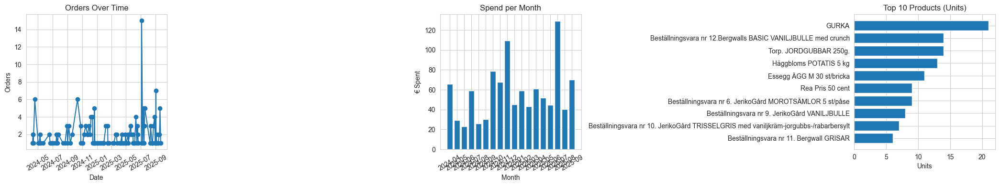

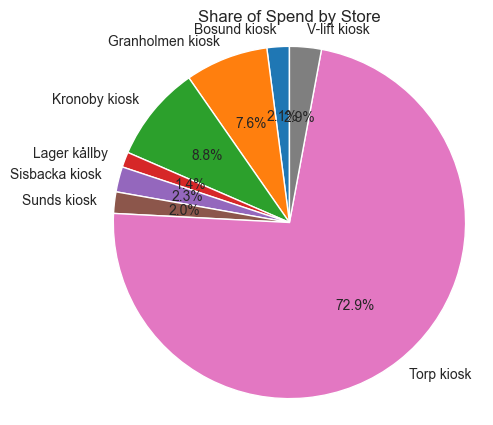

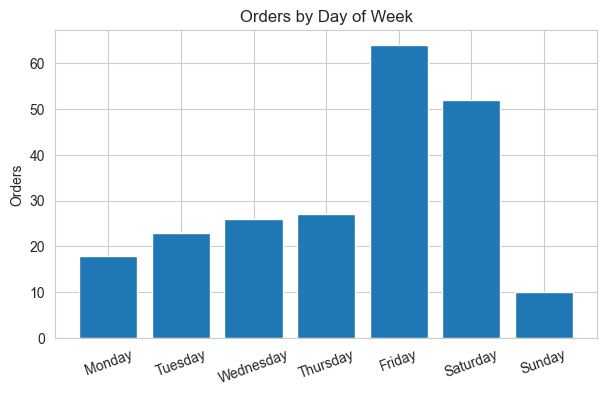

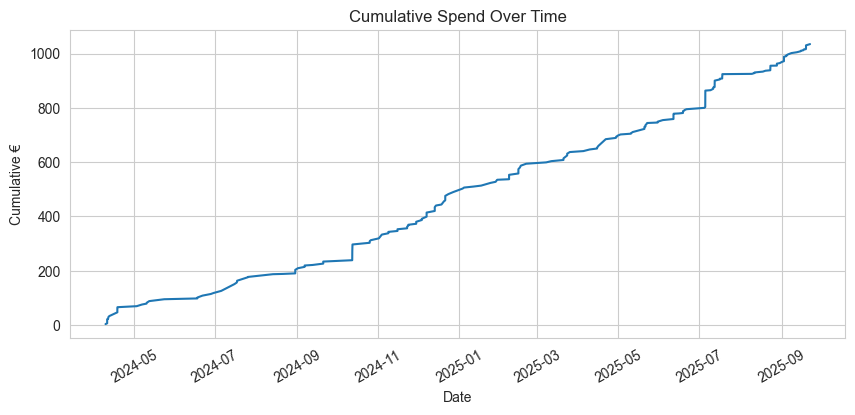

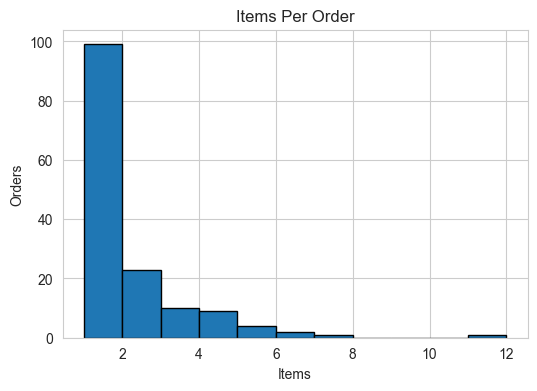

In [22]:
# Plot many things for ralf.snellman@torpfrys.fi (change email if desired)
import matplotlib.pyplot as plt

customer_email = "ralf.snellman@torpfrys.fi"
customer_orders = df[df['email'] == customer_email].copy()

if customer_orders.empty:
    print(f"No orders found for {customer_email}.")
else:
    # Orders data display
    print(f"Orders for {customer_email}:")
    display(customer_orders[['order_id', 'updated', 'store', 'name', 'quantity', 'line_price']])

    # Summary statistics
    total_orders = customer_orders['order_id'].nunique()
    total_items = customer_orders['quantity'].sum()
    total_spent = customer_orders['line_price'].sum()
    first_order = customer_orders['updated'].min()
    last_order = customer_orders['updated'].max()
    most_orders_store = customer_orders['store'].mode().iat[0]

    print(f"\nSummary for {customer_email}")
    print(f"Total orders:     {total_orders}")
    print(f"Total items:      {total_items}")
    print(f"Total spent:      €{total_spent:.2f}")
    print(f"First order:      {first_order}")
    print(f"Last order:       {last_order}")
    print(f"Most frequent store: {most_orders_store}")
    print()

    # 1-3: Wider (Make the first 3 plots wider, e.g., figsize=(21,4))
    plt.figure(figsize=(21,4))
    # 1. Orders over time
    order_dates = pd.to_datetime(customer_orders['updated']).dt.date
    order_counts = order_dates.value_counts().sort_index()
    plt.subplot(1, 3, 1)
    plt.plot(order_counts.index, order_counts.values, marker='o')
    plt.title('Orders Over Time')
    plt.xlabel('Date')
    plt.ylabel('Orders')
    plt.xticks(rotation=30)

    # 2. Spend per month
    customer_orders['month'] = pd.to_datetime(customer_orders['updated']).dt.to_period('M')
    monthly_spend = customer_orders.groupby('month')['line_price'].sum()
    plt.subplot(1, 3, 2)
    plt.bar(monthly_spend.index.astype(str), monthly_spend.values)
    plt.title('Spend per Month')
    plt.xlabel('Month')
    plt.ylabel('€ Spent')
    plt.xticks(rotation=30)

    # 3. Most purchased products
    top_products = customer_orders.groupby('name')['quantity'].sum().sort_values(ascending=False).head(10)
    plt.subplot(1, 3, 3)
    plt.barh(top_products.index[::-1], top_products.values[::-1])
    plt.title('Top 10 Products (Units)')
    plt.xlabel('Units')
    plt.tight_layout()
    plt.show()

    # 4. Pie: Share of spend by store
    if customer_orders['store'].nunique() > 1:
        store_share = customer_orders.groupby('store')['line_price'].sum()
        plt.figure(figsize=(5,5))
        plt.pie(store_share, labels=store_share.index, autopct='%1.1f%%', startangle=90)
        plt.title('Share of Spend by Store')
        plt.axis('equal')
        plt.show()

    # 5. Orders by day of week
    customer_orders['day'] = pd.to_datetime(customer_orders['updated']).dt.day_name()
    dow_counts = customer_orders['day'].value_counts().reindex(
        ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
    plt.figure(figsize=(7,4))
    plt.bar(dow_counts.index, dow_counts.values)
    plt.title('Orders by Day of Week')
    plt.ylabel('Orders')
    plt.xticks(rotation=20)
    plt.show()

    # 6. Cumulative spend over time
    tmp = customer_orders.sort_values('updated')
    tmp['cum_spend'] = tmp['line_price'].cumsum()
    plt.figure(figsize=(10,4))
    plt.plot(pd.to_datetime(tmp['updated']), tmp['cum_spend'])
    plt.title('Cumulative Spend Over Time')
    plt.xlabel('Date')
    plt.ylabel('Cumulative €')
    plt.xticks(rotation=30)
    plt.show()

    # 7. Items per order histogram
    order_item_counts = customer_orders.groupby('order_id')['quantity'].sum()
    # Ensure the bin edges are integers
    max_items = int(order_item_counts.max())
    # If max_items is less than 1 (edge case), default to bins [1, 2]
    bins = list(range(1, max(2, max_items + 2)))
    plt.figure(figsize=(6,4))
    plt.hist(order_item_counts, bins=bins, edgecolor='k')
    plt.title('Items Per Order')
    plt.xlabel('Items')
    plt.ylabel('Orders')
    plt.show()


Global last date: 2025-09-29
Test set: 4 full weeks, from 2025-09-01 to 2025-09-28


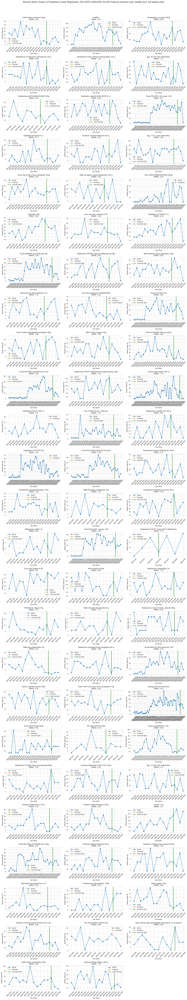

Linear Regression RMSE per product (sorted):
                                     product      rmse
48              Taffel Sips potatischips 75g  0.268994
66          Mehukatti Trip apelsindryck 2 dl  0.501868
32            Maitokolmio Gräddfil 10% 200 g  0.603846
68                       Hetki Issallad 100g  0.694138
47  Maitokolmio Crème Fraiche Laktosfri 200g  0.755414
..                                       ...       ...
38     Kokkikartano Köttbullar med mos 350 g  7.001519
29                 GLASS olika smaker 480 ml  7.097857
5            Ägg  24 st M  från Österbotten.  7.771694
55                   SIA Glass SÖTIS fruktis  8.175833
58     Snellman Malet kött av Nöt <20% 400 g  9.449458

[74 rows x 2 columns]


In [12]:
# Predict weekly sales (Monday-Sunday) for each product in Bosund store using linear regression with feature engineering
# Add a green line in the plot to mark the boundary between train and test set (always at a week boundary)
# Ensure no data leakage: rolling features and splits are computed only on past data
# Skip products with 0 sales. Plot by week number (sum of revenue per week).
# Test set is always a whole number of weeks (preferably 4 or 5, but always full weeks, not partial)

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import numpy as np

def create_features(df):
    """Create features for training data only"""
    df = df.copy()
    df['prev_day_sales'] = df['line_price'].shift(1)
    df['rolling_3d'] = df['line_price'].shift(1).rolling(3).mean()
    df['rolling_7d'] = df['line_price'].shift(1).rolling(7).mean()
    df['day_of_week'] = pd.to_datetime(df['date']).dt.dayofweek
    df['month'] = pd.to_datetime(df['date']).dt.month
    return df

def create_test_features(train_df, test_df):
    """Create features for test data using only training data to prevent leakage"""
    test_features = test_df.copy()
    # Use the last values from training data for rolling features
    test_features['prev_day_sales'] = train_df['line_price'].iloc[-1]  # Last training day
    test_features['rolling_3d'] = train_df['line_price'].tail(3).mean()  # Last 3 days from training
    test_features['rolling_7d'] = train_df['line_price'].tail(7).mean()  # Last 7 days from training
    # These don't need special handling
    test_features['day_of_week'] = pd.to_datetime(test_features['date']).dt.dayofweek
    test_features['month'] = pd.to_datetime(test_features['date']).dt.month
    return test_features

# Filter Bosund store data and ensure date is datetime
bosund_df = df[df['store'] == 'Bosund kiosk'].copy()
bosund_df['date'] = pd.to_datetime(bosund_df['updated']).dt.date

# Find the global last date and align the test set to full weeks (Monday-Sunday)
global_last_date = bosund_df['date'].max()
# Find the last Sunday on or before the last date
last_sunday = pd.to_datetime(global_last_date) - pd.Timedelta(days=(pd.to_datetime(global_last_date).weekday() + 1) % 7)
# Set test set to be the last N full weeks (e.g. 4 or 5 weeks, but always full weeks)
n_test_weeks = 4
test_end_date = last_sunday
test_start_date = test_end_date - pd.Timedelta(days=7 * n_test_weeks - 1)
test_start_date = test_start_date.date()
test_end_date = test_end_date.date()

print(f"Global last date: {global_last_date}")
print(f"Test set: {n_test_weeks} full weeks, from {test_start_date} to {test_end_date}")

products = bosund_df['name'].unique()

results = []
plot_products = []
plot_data = []
split_lines = []  # To store the week where the train/test split occurs for each product

for product in products:
    product_df = bosund_df[bosund_df['name'] == product].copy()
    # Aggregate daily sales for this product
    daily_product_sales = product_df.groupby('date')['line_price'].sum().reset_index()
    daily_product_sales = daily_product_sales.sort_values('date').reset_index(drop=True)
    
    # Skip if all sales are zero
    if (daily_product_sales['line_price'] == 0).all():
        continue

    # If not enough data, skip
    if len(daily_product_sales) < 10:
        continue

    # Split into train/test FIRST, before any feature engineering
    daily_product_sales['date_dt'] = pd.to_datetime(daily_product_sales['date'])
    train = daily_product_sales[daily_product_sales['date_dt'] < pd.to_datetime(test_start_date)].copy()
    test = daily_product_sales[(daily_product_sales['date_dt'] >= pd.to_datetime(test_start_date)) & (daily_product_sales['date_dt'] <= pd.to_datetime(test_end_date))].copy()
    
    # Skip if not enough data in train or test set
    if len(train) < 10 or len(test) < 7:  # Need at least 10 training days and 1 week of test data
        continue

    # Feature engineering: create features ONLY on training data
    train_features = create_features(train)
    
    # Handle NaN values in training features
    feature_cols = ['prev_day_sales', 'rolling_3d', 'rolling_7d', 'day_of_week', 'month']
    for col in feature_cols:
        if train_features[col].isna().any():
            mean_val = train_features[col].mean()
            train_features[col] = train_features[col].fillna(mean_val)
    
    # Create test features using only training data (no leakage)
    test_features = create_test_features(train, test)
    
    # Prepare features and target
    X_train = train_features[feature_cols].values
    y_train = train_features['line_price'].values
    X_test = test_features[feature_cols].values
    y_test = test_features['line_price'].values

    # Fit linear regression
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Predict on test set
    y_pred = model.predict(X_test)

    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    results.append({'product': product, 'rmse': rmse})

    # For plotting: group actual and predicted by week number (sum revenue per week)
    # Prepare a DataFrame for all data (train + test) with predictions for test
    all_plot_df = daily_product_sales[['date_dt', 'line_price']].copy()
    all_plot_df['actual'] = all_plot_df['line_price']
    all_plot_df['pred'] = np.nan
    # Fill predictions only for test set dates
    test_date_mask = all_plot_df['date_dt'].isin(test['date_dt'])
    all_plot_df.loc[test_date_mask, 'pred'] = y_pred

    # Add year and week columns
    all_plot_df['year'] = all_plot_df['date_dt'].dt.isocalendar().year
    all_plot_df['week'] = all_plot_df['date_dt'].dt.isocalendar().week

    # Group by year and week for actual and predicted
    weekly_actual = all_plot_df.groupby(['year', 'week'])['actual'].sum().reset_index()
    weekly_pred = all_plot_df.groupby(['year', 'week'])['pred'].sum().reset_index()

    # Merge for plotting
    weekly_plot = pd.merge(weekly_actual, weekly_pred, on=['year', 'week'], how='outer').sort_values(['year', 'week'])
    # For x-axis, use a tuple (year, week) to avoid ambiguity across years
    weekly_plot['year_week'] = weekly_plot.apply(lambda row: f"{int(row['year'])}-W{int(row['week']):02d}", axis=1)

    # Only show predictions for weeks where there is no actual data (i.e., only for test weeks)
    # This ensures that for the last week of history, there is only a blue point, not an orange one.
    # Find the week where the test set starts (for green line)
    test_start_year = pd.to_datetime(test_start_date).isocalendar().year
    test_start_week = pd.to_datetime(test_start_date).isocalendar().week
    split_week_label = f"{int(test_start_year)}-W{int(test_start_week):02d}"
    split_lines.append(split_week_label)

    # Mask out predictions for weeks where actuals exist (i.e., only show predictions for weeks with no actuals)
    # This is done by setting pred to NaN for all weeks where actual is not NaN
    weekly_plot['pred_plot'] = np.where(weekly_plot['actual'].isna(), weekly_plot['pred'], np.nan)

    plot_products.append(product)
    plot_data.append((weekly_plot['year_week'], weekly_plot['actual'], weekly_plot['pred_plot'], rmse, weekly_plot['pred'], weekly_plot['pred'], weekly_plot['pred'], weekly_plot['pred'], weekly_plot['pred']))

# Prepare subplots: one for each product that passed the filter
n_products = len(plot_products)
n_cols = 3
n_rows = int(np.ceil(n_products / n_cols))
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4), sharex=False)
axes = axes.flatten()

for i, (product, (year_weeks, actual, pred_plot, rmse, *_)) in enumerate(zip(plot_products, plot_data)):
    ax = axes[i]
    # Plot actuals as a solid blue line
    ax.plot(year_weeks, actual, label='Actual', marker='o', color='tab:blue')
    # Plot predictions as a solid orange line, but only for test weeks (where there is no actual)
    ax.plot(year_weeks, pred_plot, label='Predicted', marker='o', linestyle='--', color='tab:orange')
    # Add green vertical line at the train/test split
    split_week = split_lines[i]
    if split_week in list(year_weeks):
        split_idx = list(year_weeks).index(split_week)
        ax.axvline(x=year_weeks.iloc[split_idx], color='green', linestyle='-', linewidth=2, label='Train/Test Split')
    ax.set_title(f"{product}\nRMSE: {rmse:.2f}")
    ax.set_xlabel('Year-Week')
    ax.set_ylabel('Weekly Sales (€)')
    ax.legend()
    ax.tick_params(axis='x', rotation=45)

# Hide any unused subplots
for j in range(n_products, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle('Bosund Store: Actual vs Predicted (Linear Regression, NO DATA LEAKAGE) for All Products (nonzero only, weekly sum, full weeks only)', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()

# Show RMSE for each product
results_df = pd.DataFrame(results).sort_values('rmse')
print("Linear Regression RMSE per product (sorted):")
print(results_df)

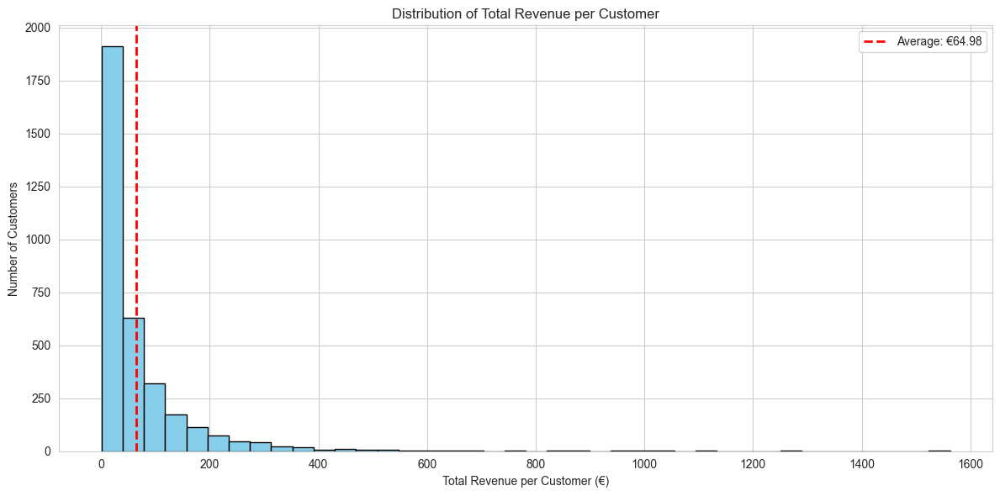

In [13]:
# Plot the average revenue per customer
import matplotlib.pyplot as plt

# Calculate total revenue per customer
customer_revenue = df.groupby('email')['line_price'].sum()

# Calculate average revenue per customer
avg_revenue = customer_revenue.mean()

plt.figure(figsize=(12, 6))
plt.hist(customer_revenue, bins=40, color='skyblue', edgecolor='black')
plt.axvline(avg_revenue, color='red', linestyle='dashed', linewidth=2, label=f'Average: €{avg_revenue:.2f}')
plt.title('Distribution of Total Revenue per Customer')
plt.xlabel('Total Revenue per Customer (€)')
plt.ylabel('Number of Customers')
plt.legend()
plt.tight_layout()
plt.show()

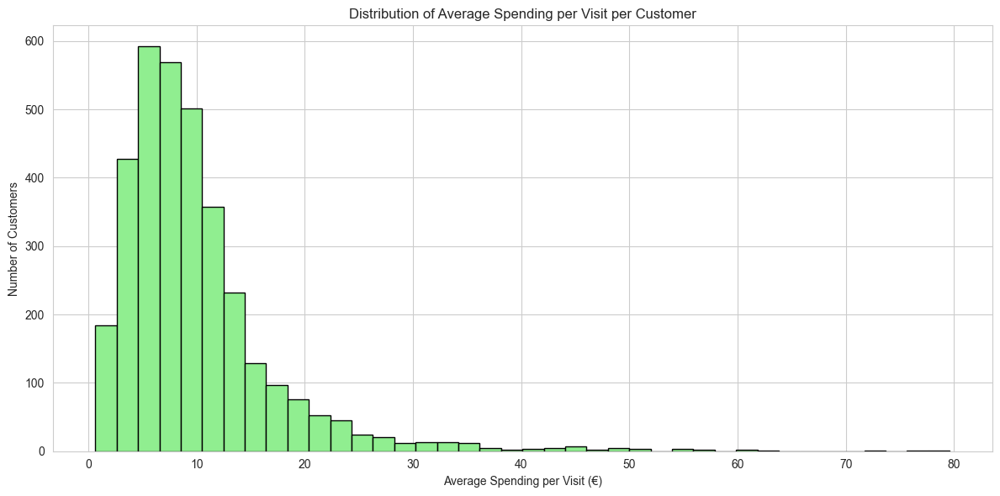

In [14]:
# Calculate average spending per visit per customer
# "Visit" is defined as a unique order (order_id) per customer (email)
customer_order_totals = df.groupby(['email', 'order_id'])['line_price'].sum().reset_index()
avg_spending_per_visit = customer_order_totals.groupby('email')['line_price'].mean()

plt.figure(figsize=(12, 6))
plt.hist(avg_spending_per_visit, bins=40, color='lightgreen', edgecolor='black')
plt.title('Distribution of Average Spending per Visit per Customer')
plt.xlabel('Average Spending per Visit (€)')
plt.ylabel('Number of Customers')
plt.tight_layout()
plt.show()

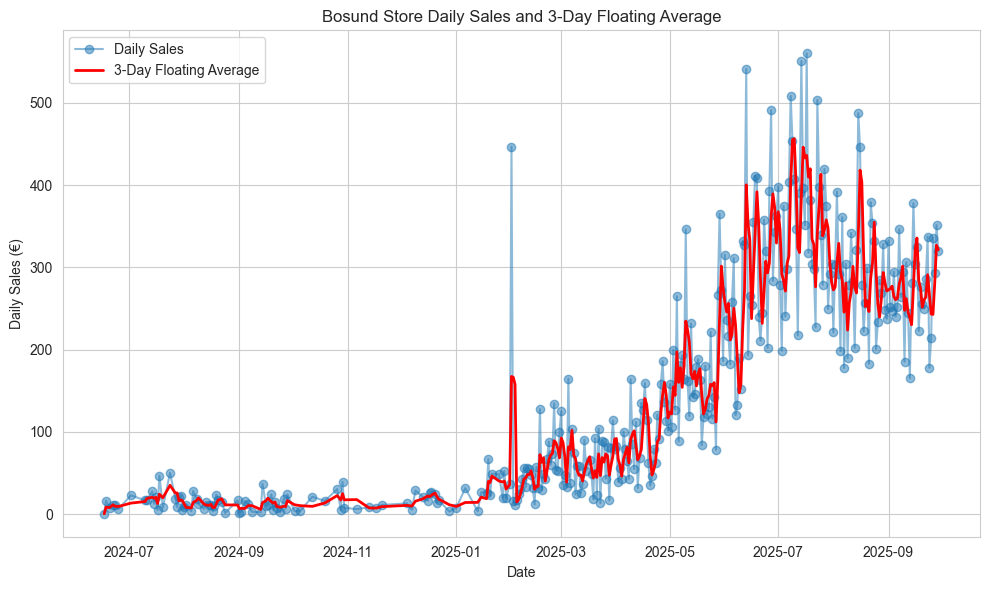

In [15]:
# Calculate 3-day floating (rolling) average of daily sales for Bosund kiosk

import pandas as pd
import matplotlib.pyplot as plt

# Filter data for Bosund kiosk
bosund_df = df[df['store'] == 'Bosund kiosk'].copy()

# Prepare daily sales data
bosund_df['date'] = pd.to_datetime(bosund_df['updated']).dt.date
daily_sales = bosund_df.groupby('date')['line_price'].sum().reset_index()
daily_sales = daily_sales.sort_values('date')

# Calculate 3-day floating (rolling) average
daily_sales['3_day_avg'] = daily_sales['line_price'].rolling(window=3, min_periods=1).mean()

# Plot the original daily sales and the 3-day floating average
plt.figure(figsize=(10, 6))
plt.plot(daily_sales['date'], daily_sales['line_price'], label='Daily Sales', alpha=0.5, marker='o')
plt.plot(daily_sales['date'], daily_sales['3_day_avg'], label='3-Day Floating Average', color='red', linewidth=2)
plt.title('Bosund Store Daily Sales and 3-Day Floating Average')
plt.xlabel('Date')
plt.ylabel('Daily Sales (€)')
plt.legend()
plt.tight_layout()
plt.show()


In [16]:
#print all the stores
print(df['store'].unique())

['Bosund kiosk' 'Kronoby kiosk' 'Sisbacka kiosk' 'V-lift kiosk'
 'Sunds kiosk' 'Torp kiosk' 'Granholmen kiosk' 'Holm kiosk' 'Lager kållby']


In [17]:
# For each product in Bosund store, fit a linear regression model on all available history, then predict sales for the next 4 full weeks (Monday to Sunday).
# Plot the full history and the next month's predictions for each product, aggregated by week.
# Sales can never be negative.

from sklearn.linear_model import LinearRegression

future_weeks = 4
products = bosund_df['name'].unique()
fig, axes = plt.subplots(len(products), 1, figsize=(18, 6 * len(products)), sharex=False)

if len(products) == 1:
    axes = [axes]

for idx, product in enumerate(products):
    prod_df = bosund_df[bosund_df['name'] == product].copy()
    daily = prod_df.groupby('date')['line_price'].sum().reset_index()
    daily = daily.sort_values('date')
    daily['date'] = pd.to_datetime(daily['date'])
    daily = daily.set_index('date').asfreq('D', fill_value=0).reset_index()

    # Feature engineering
    daily['dayofweek'] = daily['date'].dt.dayofweek
    daily['month'] = daily['date'].dt.month
    daily['day'] = daily['date'].dt.day
    daily['is_weekend'] = daily['dayofweek'].isin([5, 6]).astype(int)

    # Prepare X, y
    X = daily[['dayofweek', 'month', 'day', 'is_weekend']]
    y = daily['line_price']

    # Fit model
    model = LinearRegression()
    model.fit(X, y)

    # Prepare future dates: always full weeks (Monday to Sunday), for the next 4 weeks
    last_date = daily['date'].max()
    # Find the next Monday after last_date (if last_date is Monday, start from next week)
    days_ahead = (7 - last_date.weekday()) % 7
    if days_ahead == 0:
        days_ahead = 7
    first_future_monday = last_date + pd.Timedelta(days=days_ahead)
    total_future_days = future_weeks * 7
    future_dates = pd.date_range(first_future_monday, periods=total_future_days, freq='D')
    future_df = pd.DataFrame({'date': future_dates})
    future_df['dayofweek'] = future_df['date'].dt.dayofweek
    future_df['month'] = future_df['date'].dt.month
    future_df['day'] = future_df['date'].dt.day
    future_df['is_weekend'] = future_df['dayofweek'].isin([5, 6]).astype(int)
    X_future = future_df[['dayofweek', 'month', 'day', 'is_weekend']]

    # Predict future, ensure no negative sales
    y_future = model.predict(X_future)
    y_future = np.maximum(y_future, 0)

    # Combine history and future for weekly aggregation
    history_df = daily[['date', 'line_price']].copy()
    history_df['type'] = 'History'
    history_df = history_df.rename(columns={'line_price': 'sales'})

    future_df['sales'] = y_future
    future_df['type'] = 'Forecast'
    combined_df = pd.concat([history_df, future_df[['date', 'sales', 'type']]], ignore_index=True)

    # Add year and week columns for grouping
    combined_df['year'] = combined_df['date'].dt.isocalendar().year
    combined_df['week'] = combined_df['date'].dt.isocalendar().week

    # Aggregate by week and type
    weekly = combined_df.groupby(['year', 'week', 'type'])['sales'].sum().reset_index()
    # For x-axis, use a tuple (year, week) to avoid ambiguity across years
    weekly['year_week'] = weekly.apply(lambda row: f"{int(row['year'])}-W{int(row['week']):02d}", axis=1)

    # Split history and forecast for plotting
    weekly_history = weekly[weekly['type'] == 'History']
    weekly_forecast = weekly[weekly['type'] == 'Forecast']

    # Find the first forecast week that is not already in history
    history_weeks = set(weekly_history['year_week'])
    forecast_weeks = list(weekly_forecast['year_week'])
    forecast_sales = list(weekly_forecast['sales'])

    ax = axes[idx]
    # Plot history
    ax.plot(weekly_history['year_week'], weekly_history['sales'], label='History (weekly sum)', marker='o', color='tab:blue')

    # Connect the last history week to the first forecast week with a "constant" line
    if forecast_weeks:
        last_hist_week = weekly_history['year_week'].iloc[-1]
        last_hist_sales = weekly_history['sales'].iloc[-1]
        first_forecast_week = forecast_weeks[0]
        first_forecast_sales = forecast_sales[0]

        # If the first forecast week is the same as the last history week, just plot the forecast as usual
        if first_forecast_week == last_hist_week:
            # Plot a horizontal line (constant) from last history week to first forecast week (which are the same)
            # Plot forecast points, skipping the first (overlap) week for orange dots, but keep the constant line
            plot_forecast_weeks = forecast_weeks[1:]
            plot_forecast_sales = forecast_sales[1:]
            # Draw a constant line from last history week to first forecast week (which are the same)
            ax.plot([last_hist_week, first_forecast_week], [last_hist_sales, first_forecast_sales],
                    color='tab:orange', linestyle='--', marker='o', label='Forecast (weekly sum)')
            # If more forecast weeks, draw a constant line from first forecast week to the next, and so on
            prev_week = first_forecast_week
            prev_sales = first_forecast_sales
            for w, s in zip(plot_forecast_weeks, plot_forecast_sales):
                ax.plot([prev_week, w], [prev_sales, s], color='tab:orange', linestyle='--', marker='o')
                prev_week = w
                prev_sales = s
        else:
            # Draw a constant line from last history week to first forecast week
            ax.plot([last_hist_week, first_forecast_week], [last_hist_sales, first_forecast_sales],
                    color='tab:orange', linestyle='--', marker='o', label='Forecast (weekly sum)')
            # Then for the rest of the forecast weeks, draw constant lines between each week
            prev_week = first_forecast_week
            prev_sales = first_forecast_sales
            for w, s in zip(forecast_weeks[1:], forecast_sales[1:]):
                ax.plot([prev_week, w], [prev_sales, s], color='tab:orange', linestyle='--', marker='o')
                prev_week = w
                prev_sales = s

    ax.set_title(f"{product} - Bosund Store: Weekly History and Next 4 Weeks Forecast")
    ax.set_xlabel('Year-Week')
    ax.set_ylabel('Weekly Sales (€)')
    ax.legend()
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()
